# Extended Kalman Filter for online SLAM

Simultaneous localization and mapping (SLAM) is a chicken-and-egg problem. It tries to solve the problem of localizing the robot in a map while building the map.

__Localization__ : Estimate the robot path, i.e., a sequence of poses and locations,
$$
x_{0:T} = {x_{0}, x_{1}, x_{2}, ..., x_{T}}
$$
where $1:T$ denotes the timestep from 1 to T and $x_0$ is the initial robot pose. 

__Mapping__ : Build a map of the environment, $m$



## Online SLAM

In contrast to full SLAM, which estimate the full robot path and the map at once, online SLAM estimates only the most recent robot pose together with the map at each time step t.
$$
p(x_t, m \vert z_{1:t}, u_{1:t})
$$
which can be done by marginalizing out the previous poses (recursively):
$$
p(x_{t}, m | z_{1:t}, u_{1:t}) = \int_{x_0} ... \int_{x_{t-1}} p(x_{0:t}, m | z_{1:t}, u_{1:t}) dx_{t-1} ... dx_{0}
$$

| ![Graphical model of online SLAM](https://www.dropbox.com/s/zcl4egxe6trgx1i/online-slam.png?dl=1) |
| :----------------------------------------------------------: |
| Graphical model Online SLAM [[Probabilistic robotics]](http://probabilistic-robotics.informatik.uni-freiburg.de/) |


## Bayes Filter

Bayes filter provides a recursive tool to estimate the map and the robot poses given the robot odometry and observations. Bayes filter consists of two steps: the prediction step and the correction step. 

__Prediction step__ : Predict the expected robot pose given the previous robot pose and robot odometry

__Correction step__ : Correct the predicted robot pose given the robot observations and update the map

The two steps take place in turns recursively until the all robot poses are estimated and the map is constructed.



## Extended Kalman Filter

Bayes filter plays well with SLAM because of its capability of modeling the uncertainty with certain assumptions. The typical assumptions are:

- The measurement noise, in both robot odometry and robot observations, are __Gaussian__
- The robot motion model as well as observation model are __linear__

That boils down the category of Bayes filter to the Kalman filter and it's variants. The most commonly used variants is the Extended Kalman Filter (EKF) where the robot motion model and observation model are not necessarily linear. But it still requires the local linearity from those two models so that a first-order Taylor expansion can be performed to linearize the motion model and the observation model.

## A 2-dimentional example

Now the fun part comes. Assume a robot lives in a 2D world. It is capable of rotate and translate in the world. Other than the robot, there are also a fixed number of asterisks planted in the same 2D world. The robot could observe them but cannot move them. We are provided the noisy measurements about the robot moves and observations and the goal is to build a map of this 2D world and localize the robot in this map at each time step. 

In [1]:
using Pkg
Pkg.add(PackageSpec(url="https://github.com/JihongJu/SlamTutorial.jl", rev="master"))

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
  Updating git-repo `https://github.com/JihongJu/SlamTutorial.jl`
 Resolving package versions...
  Updating `~/.julia/environments/v1.1/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.1/Manifest.toml`
 [no changes]


┌ Info: Recompiling stale cache file /home/jihong/.julia/compiled/v1.1/SlamTutorial/5dqMH.ji for SlamTutorial [94bac306-920f-11e9-2cb9-335deda059ba]
└ @ Base loading.jl:1184


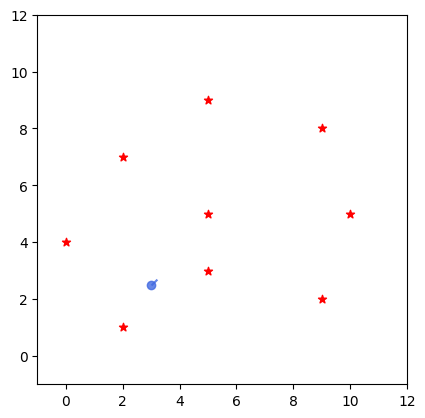

2-element Array{Any,1}:
 PyObject <matplotlib.collections.PathCollection object at 0x7f2c4202a0b8>
 PyObject <matplotlib.collections.PathCollection object at 0x7f2c4202a4a8>

In [2]:
import SlamTutorial: 
    make_canvas, draw_2d_robot,
    example2d_landmarks

fig, ax = make_canvas(-1, -1, 12, 12)

landmarks = example2d_landmarks()
ax.scatter(landmarks[:, 1], landmarks[:, 2], marker="*", color="r")  # Draw asterisks

draw_2d_robot(ax, [3, 2.5, π/4])

###  The motion model: standard odometry model

| ![odometry](https://www.mrpt.org/wp-content/uploads/2010/08/Motion_model_thrun.png) |
| :--: | 
| Robot motion model [[Figure from www.mrpt.org]](http://www.mrpt.org) |

The robot odometry readings at each time step is:
$$ u = (\delta_{rot1}, \delta_{trans}, \delta_{rot2}) $$

The robot motion update is given by:

$$
\begin{pmatrix}
x' \\
y' \\
\theta' \\
\end{pmatrix}
= 
\begin{pmatrix}
x \\
y \\
\theta \\
\end{pmatrix}
+
\begin{pmatrix}
  \delta_{trans} \cos(\theta + \delta_{rot1}) \\
  \delta_{trans} \sin(\theta + \delta_{rot1}) \\
  \delta_{rot1} + \delta_{rot2}
\end{pmatrix}
$$

In [3]:
struct Odometry
    rot1::Float32
    trans::Float32
    rot2::Float32
end


function standard_odometry_model(pose, odometry)
    rx, ry, rθ = pose
    direction = rθ + odometry.rot1
    rx += odometry.trans * cos(direction)
    ry += odometry.trans * sin(direction)
    rθ += odometry.rot1 + odometry.rot2
    rθ = rem2pi(rθ, RoundNearest)  # Round to [-π, π]
    return [rx, ry, rθ]
end

standard_odometry_model (generic function with 1 method)

### The observation model: Range-bearing observation


| ![range-bearing](https://ai2-s2-public.s3.amazonaws.com/figures/2017-08-08/0348cc294883adf24b48c00f50df9870983317d2/46-Figure3.6-1.png) |
| :--: | 
| Robot observation model [[Montemerlo, Michael, et al.]](https://www.aaai.org/Papers/AAAI/2002/AAAI02-089.pdf) | 


Assume the robot can associate the observed asterisk (landmark) with its unique id, the sensor reading for the 
i-th asterisk at time step t is:

$$z_t^i = (r_t^i, \phi_t^i)^T$$

This leads to the prediction of the i-th asterisk position at time step t:

$$
\begin{pmatrix}
\bar \mu_{j,x} \\
\bar \mu_{j,y} \\
\end{pmatrix}
=
\begin{pmatrix}
\bar \mu_{t,x} \\
\bar \mu_{t,y} \\
\end{pmatrix}
+
\begin{pmatrix}
r_t^i \cos(\phi_t^i + \bar \mu_{t, \theta}) \\
r_t^i \sin(\phi_t^i + \bar \mu_{t, \theta}) \\
\end{pmatrix}
$$

In [4]:
struct RangeBearing
    landmark_id::Int8
    range::Float32
    bearing::Float32
end


function range_bearing_model(robot_pose, range_bearing)
    rx, ry, rθ = robot_pose
    range, bearing = range_bearing.range, range_bearing.bearing
    mx = rx + range * cos(bearing + rθ)
    my = ry + range * sin(bearing + rθ)
    return [mx, my]
end

range_bearing_model (generic function with 1 method)

## State representation for EKF

State represents an estimation, a.k.a, a belief, of the robot's pose $(x,y,\theta)$ and locations of n landmarks:

$$ x_t = (x, y, \theta, m_{1,x}, m_{1,y}, \dots, m_{n, x}, m_{n, y}) $$

Assuming the robot pose and the landmark locations are both Gaussian distribution, the probabilistic representation of the state is the mean and the variance:


$$
\mu = (x, y, \theta, m_{1,x}, m_{1,y}, \dots, m_{n, x}, m_{n, y})
$$

$$
\Sigma = 
\begin{pmatrix}
\sigma_{xx} & \sigma_{xy} & \sigma_{x\theta} & | & \sigma_{x m_{1,x}} & \sigma_{x m_{1,y}} & \ldots & \sigma_{x m_{n,y}} & \sigma_{x m_{n,y}} \\
\sigma_{yx} & \sigma_{yy} & \sigma_{y\theta} & | & \sigma_{y m_{1,x}} & \sigma_{y m_{1,y}} & \ldots & \sigma_{y m_{n,y}} & \sigma_{y m_{n,y}} \\
\sigma_{\theta x} & \sigma_{\theta y} & \sigma_{\theta \theta} & | & \sigma_{\theta m_{1,x}} & \sigma_{\theta m_{1,y}} & \ldots & \sigma_{\theta m_{n,y}} & \sigma_{\theta m_{n,y}} \\
- & - & - & | & - & - & - & - & - \\
\sigma_{m_{1,x}x} & \sigma_{m_{1,x}y} & \sigma_{m_{1,x}\theta} & | & \sigma_{m_{1,x} m_{1,x}} & \sigma_{m_{1,x} m_{1,y}} & \ldots & \sigma_{m_{1,x} m_{n,y}} & \sigma_{m_{1,x} m_{n,y}} \\
\sigma_{m_{1,y}x} & \sigma_{m_{1,y}y} & \sigma_{m_{1,y}\theta} & | & \sigma_{m_{1,y} m_{1,x}} & \sigma_{m_{1,y} m_{1,y}} & \ldots & \sigma_{m_{1,y} m_{n,y}} & \sigma_{m_{1,y} m_{n,y}} \\
\vdots  & \vdots & \vdots & |  & \vdots & \vdots & \ddots & \vdots & \vdots\\
\sigma_{m_{n,x}x} & \sigma_{m_{n,x}y} & \sigma_{m_{n,x}\theta} & | & \sigma_{m_{n,x} m_{1,x}} & \sigma_{m_{n,x} m_{1,y}} & \ldots & \sigma_{m_{n,x} m_{n,y}} & \sigma_{m_{n,x} m_{n,y}} \\
\sigma_{m_{n,y}x} & \sigma_{m_{n,y}y} & \sigma_{m_{n,y}\theta} & | & \sigma_{m_{n,y} m_{1,x}} & \sigma_{m_{n,y} m_{1,y}} & \ldots & \sigma_{m_{n,y} m_{n,y}} & \sigma_{m_{n,y} m_{n,y}} \\
\end{pmatrix}
$$



Or, in simpler form,


$$
\mu = 
\begin{pmatrix}
x \\
m \\
\end{pmatrix}
$$

$$
\Sigma = 
\begin{pmatrix}
\Sigma_{xx} & \Sigma_{xm} \\
\Sigma_{mx} & \Sigma_{mm} \\
\end{pmatrix}
$$


### State Initialization

The mean and covariance matrix of the state are initialized with:

$$
\mu_0 = 
\begin{pmatrix}
0 \\
0 \\ 
\vdots \\
0 \\
\end{pmatrix}
$$


$$
\Sigma_0 = 
\begin{pmatrix}
0 & 0 & 0 & 0 & \ldots & 0 \\
0 & 0 & 0 & 0 & \ldots & 0 \\
0 & 0 & 0 & 0 & \ldots & 0 \\
0 & 0 & 0 & \infty & \ldots & 0 \\
0 & 0 & 0 & \vdots & \ddots & \vdots \\
0 & 0 & 0 & 0 & \ldots & \infty \\
\end{pmatrix}
$$

In [5]:
using LinearAlgebra

mutable struct Belief
    mean::Vector{Union{Float32, Missing}}
    covariance::Matrix{Float32}
end

function belief_init(num_landmarks)
    μ = Vector{Union{Float32, Missing}}(missing, 3 + 2*num_landmarks)
    μ[1:3] .= 0
    Σ = zeros(Float32, 3+2*num_landmarks, 3+2*num_landmarks)
    Σ[diagind(Σ)[1:3]] .= 0
    Σ[diagind(Σ)[4:end]] .= 1000

    return Belief(μ, Symmetric(Σ))
end


belief_init (generic function with 1 method)

## Prediction step

In [6]:
function prediction_step(belief, odometry)
    # Compute the new mu based on the noise-free (odometry-based) motion model
    rx, ry, rθ = belief.mean[1:3]
    belief.mean[1:3] = standard_odometry_model([rx, ry, rθ], odometry)

    # Compute the 3x3 Jacobian Gx of the motion model
    Gx = Matrix{Float32}(I, 3, 3)
    heading = rθ + odometry.rot1
    Gx[1, 3] -= odometry.trans * sin(heading)  # ∂x'/∂θ
    Gx[2, 3] += odometry.trans * cos(heading)  # ∂y'/∂θ

    # Motion noise
    Rx = Diagonal{Float32}([0.1, 0.1, 0.01])

    # Compute the predicted sigma after incorporating the motion
    Σxx = belief.covariance[1:3, 1:3]
    Σxm = belief.covariance[1:3, 4:end]

    Σ = Matrix(belief.covariance)
    Σ[1:3, 1:3] = Gx * Σxx * Gx' + Rx
    Σ[1:3, 4:end] = Gx * Σxm
    belief.covariance = Symmetric(Σ)

end


prediction_step (generic function with 1 method)

## Correction step

In [7]:
function correction_step(belief, range_bearings)
    rx, ry, rθ = belief.mean[1:3]

    num_range_bearings = length(range_bearings)
    num_dim_state = length(belief.mean)

    H = Matrix{Float32}(undef, 2 * num_range_bearings, num_dim_state) # Jacobian matrix ∂ẑ/∂(rx,ry)
    zs, ẑs = [], []  # true and predicted observations

    for (i, range_bearing) in enumerate(range_bearings)
        mid = range_bearing.landmark_id
        if ismissing(belief.mean[2*mid+2])
            # Initialize its pose in mu based on the measurement and the current robot pose
            mx, my = range_bearing_model([rx, ry, rθ], range_bearing)
            belief.mean[2*mid+2:2*mid+3] = [mx, my]
        end
        # Add the landmark measurement to the Z vector
        zs = [zs; range_bearing.range; range_bearing.bearing]

        # Use the current estimate of the landmark pose
        # to compute the corresponding expected measurement in z̄:
        mx, my = belief.mean[2*mid+2:2*mid+3]
        δ = [mx - rx, my - ry]
        q = dot(δ, δ)
        sqrtq = sqrt(q)

        ẑs = [ẑs; sqrtq; atan(δ[2], δ[1]) - rθ]

        # Compute the Jacobian Hi of the measurement function h for this observation
        δx, δy = δ
        Hi = zeros(Float32, 2, num_dim_state)
        Hi[1:2, 1:3] = [
            -sqrtq * δx  -sqrtq * δy   0;
            δy           -δx           -q
        ] / q
        Hi[1:2, 2*mid+2:2*mid+3] = [
            sqrtq * δx sqrtq * δy;
            -δy δx
        ] / q

        # Augment H with the new Hi
        H[2*i-1:2*i, 1:end] = Hi
    end

    # Construct the sensor noise matrix Q
    Q = Diagonal{Float32}(ones(2 * num_range_bearings) * 0.01)

    # Compute the Kalman gain K
    K = belief.covariance * H' * inv(H * belief.covariance * H' + Q)

    # Compute the difference between the expected and recorded measurements.
    Δz = zs - ẑs
    # Normalize the bearings
    Δz[2:2:end] = map(bearing->rem2pi(bearing, RoundNearest), Δz[2:2:end])

    # Finish the correction step by computing the new mu and sigma.
    belief.mean += K * Δz
    I = Diagonal{Float32}(ones(num_dim_state))
    belief.covariance = Symmetric((I - K * H) * belief.covariance)

    # Normalize theta in the robot pose.
    belief.mean[3] = rem2pi(belief.mean[3], RoundNearest)
end


correction_step (generic function with 1 method)

## Get started

Finally here we are. Let's get it started. A robot wanders into the asterisk forest.

In [8]:
import SlamTutorial: 
    make_canvas, make_animation, animate_kalman_state,
    example2d_landmarks, example2d_sensor_data

In [9]:
landmarks = example2d_landmarks()
num_landmarks = size(landmarks, 1)

odometries, range_bearingss = example2d_sensor_data()

believes = []

belief = belief_init(num_landmarks)
for t in 1:length(odometries)
    prediction_step(belief, odometries[t])
    correction_step(belief, range_bearingss[t])
    push!(believes, deepcopy(belief))
end

canvas = make_canvas(-1, -1, 11, 11)
HTML(animate_kalman_state(canvas, believes, range_bearingss, landmarks).to_jshtml())

HTML{String}("\n<link rel=\"stylesheet\"\nhref=\"https://maxcdn.bootstrapcdn.com/font-awesome/4.4.0/\ncss/font-awesome.min.css\">\n<script language=\"javascript\">\n  function isInternetExplorer() {\n    ua = navigator.userAgent;\n    /* MSIE used to detect old browsers and Trident used to newer ones*/\n    return ua.indexOf(\"MSIE \") > -1 || ua.indexOf(\"Trident/\") > -1;\n  }\n\n  /* Define the Animation class */\n  function Animation(frames, img_id, slider_id, interval, loop_select_id){\n    this.img_id = img_id;\n    this.slider_id = slider_id;\n    this.loop_select_id = loop_select_id;\n    this.interval = interval;\n    this.current_frame = 0;\n    this.direction = 0;\n    this.timer = null;\n    this.frames = new Array(frames.length);\n\n    for (var i=0; i<frames.length; i++)\n    {\n     this.frames[i] = new Image();\n     this.frames[i].src = frames[i];\n    }\n    var slider = document.getElementById(this.slider_id);\n    slider.max = this.frames.length - 1;\n    if (isInternetExplorer()) {\n        // switch from oninput to onchange because IE <= 11 does not conform\n        // with W3C specification. It ignores oninput and onchange behaves\n        // like oninput. In contrast, Mircosoft Edge behaves correctly.\n        slider.setAttribute('onchange', slider.getAttribute('oninput'));\n        slider.setAttribute('oninput', null);\n    }\n    this.set_frame(this.current_frame);\n  }\n\n  Animation.prototype.get_loop_state = function(){\n    var button_group = document[this.loop_select_id].state;\n    for (var i = 0; i < button_group.length; i++) {\n        var button = button_group[i];\n        if (button.checked) {\n            return button.value;\n        }\n    }\n    return undefined;\n  }\n\n  Animation.prototype.set_frame = function(frame){\n    this.current_frame = frame;\n    document.getElementById(this.img_id).src =\n            this.frames[this.current_frame].src;\n    document.getElementById(this.slider_id).value = this.current_frame;\n  }\n\n  Animation.prototype.next_frame = function()\n  {\n    this.set_frame(Math.min(this.frames.length - 1, this.current_frame + 1));\n  }\n\n  Animation.prototype.previous_frame = function()\n  {\n    this.set_frame(Math.max(0, this.current_frame - 1));\n  }\n\n  Animation.prototype.first_frame = function()\n  {\n    this.set_frame(0);\n  }\n\n  Animation.prototype.last_frame = function()\n  {\n    this.set_frame(this.frames.length - 1);\n  }\n\n  Animation.prototype.slower = function()\n  {\n    this.interval /= 0.7;\n    if(this.direction > 0){this.play_animation();}\n    else if(this.direction < 0){this.reverse_animation();}\n  }\n\n  Animation.prototype.faster = function()\n  {\n    this.interval *= 0.7;\n    if(this.direction > 0){this.play_animation();}\n    else if(this.direction < 0){this.reverse_animation();}\n  }\n\n  Animation.prototype.anim_step_forward = function()\n  {\n    this.current_frame += 1;\n    if(this.current_frame < this.frames.length){\n      this.set_frame(this.current_frame);\n    }else{\n      var loop_state = this.get_loop_state();\n      if(loop_state == \"loop\"){\n        this.first_frame();\n      }else if(loop_state == \"reflect\"){\n        this.last_frame();\n        this.reverse_animation();\n      }else{\n        this.pause_animation();\n        this.last_frame();\n      }\n    }\n  }\n\n  Animation.prototype.anim_step_reverse = function()\n  {\n    this.current_frame -= 1;\n    if(this.current_frame >= 0){\n      this.set_frame(this.current_frame);\n    }else{\n      var loop_state = this.get_loop_state();\n      if(loop_state == \"loop\"){\n        this.last_frame();\n      }else if(loop_state == \"reflect\"){\n        this.first_frame();\n        this.play_animation();\n      }else{\n        this.pause_animation();\n        this.first_frame();\n      }\n    }\n  }\n\n  Animation.prototype.pause_animation = function()\n  {\n    this.direction = 0;\n    if (this.timer){\n      clearInterval(this.timer);\n      this.timer = nul

This cute animation concludes the blog post. But wait, there are probably more questions about EKF-SLAM in your head than when it starts:

 - Why are the new landmarks initialized with maximum uncertainty while the rest of the covariance matrix initialized with zero uncertainty?
 - To what extent the two assumptions of the Extended Kalman Filter holds?
 - What is the time and space complexity of EKF-SLAM?
 - and many more...
 
For the anwsers to these questions, I refer you to [Cyrill Stachniss's Lecture: Robot Mapping WS 2013](http://ais.informatik.uni-freiburg.de/teaching/ws13/mapping/)

## References

[1] [Cyrill Stachniss's Lecture: Robot Mapping WS 2013](http://ais.informatik.uni-freiburg.de/teaching/ws13/mapping/)

[2] Thrun, Sebastian, Wolfram Burgard, and Dieter Fox. Probabilistic robotics. MIT press, 2005. 

[3] [Jose Luis Blanco's Blog: Probablistic motion models](https://www.mrpt.org/tutorials/programming/odometry-and-motion-models/probabilistic_motion_models/)

[4] Montemerlo, Michael, et al. "FastSLAM: A factored solution to the simultaneous localization and mapping problem." Aaai/iaai 593598 (2002).